#**CODE 1**

#Dataset

In [4]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
rtlmhjbn_ip02_dataset_path = kagglehub.dataset_download('rtlmhjbn/ip02-dataset')
print('Data source import complete.')

100%|██████████| 2.94G/2.94G [02:25<00:00, 21.7MB/s]

Extracting files...


Data source import complete.


In [5]:
#Dataset
import numpy as np
import pandas as pd
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

In [6]:
print("IP02 Dataset Path:", rtlmhjbn_ip02_dataset_path)

IP02 Dataset Path: /root/.cache/kagglehub/datasets/rtlmhjbn/ip02-dataset/versions/1


In [7]:
DATA_PATH = rtlmhjbn_ip02_dataset_path
TRAIN_DIR = os.path.join(DATA_PATH, "classification/train")
VAL_DIR = os.path.join(DATA_PATH, "classification/val")
TEST_DIR = os.path.join(DATA_PATH, "classification/test")

# Get class labels
classes = sorted(os.listdir(TRAIN_DIR))
num_classes = len(classes)
print("Classes:", classes)
print("Number of classes:", num_classes)

Classes: ['0', '1', '10', '100', '101', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '4', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '5', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '6', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '7', '70', '71', '72', '73', '74', '75', '76', '77', '78', '79', '8', '80', '81', '82', '83', '84', '85', '86', '87', '88', '89', '9', '90', '91', '92', '93', '94', '95', '96', '97', '98', '99']
Number of classes: 102


#Libraries

In [2]:
# Importing Libraries
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

import torch
import timm
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader

from torchsummary import summary
import cv2

import torchvision.models as models
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset

from tqdm import tqdm
from PIL import Image

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix, classification_report

#GPU

In [9]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


#Spatial transformations

In [14]:
# Define the Spatial Transformer Network (STN)
class STN(nn.Module):
    def __init__(self):
        super(STN, self).__init__()
        self.localization = nn.Sequential(
            nn.Conv2d(3, 8, kernel_size=7),
            nn.ReLU(True),
            nn.MaxPool2d(2, stride=2),
            nn.Conv2d(8, 10, kernel_size=5),
            nn.ReLU(True),
            nn.MaxPool2d(2, stride=2)
        )

        with torch.no_grad():
            dummy_input = torch.randn(1, 3, 224, 224)
            out = self.localization(dummy_input)
            self.flattened_size = out.view(1, -1).size(1)

        self.fc_loc = nn.Sequential(
            nn.Linear(self.flattened_size, 32),
            nn.ReLU(True),
            nn.Linear(32, 6)
        )

        # Initialize as identity transformation
        self.fc_loc[2].weight.data.zero_()
        self.fc_loc[2].bias.data.copy_(torch.tensor([0.8, 0.1, 0, -0.1, 0.8, 0], dtype=torch.float))

    def forward(self, x, return_theta=False):
        xs = self.localization(x)
        xs = xs.view(xs.size(0), -1)
        theta = self.fc_loc(xs).view(-1, 2, 3)  # Reshape to affine matrix

        #print(f"Transformation matrix (theta): {theta.detach().cpu().numpy()}")

        # Generate affine grid and apply transformation
        grid = F.affine_grid(theta, x.size(), align_corners=True)
        x_transformed = F.grid_sample(x, grid,mode='bilinear', padding_mode='border', align_corners=True)

        if return_theta:
            return x_transformed, theta
        return x_transformed


In [13]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# Define CBAM (Convolutional Block Attention Module)
class ChannelAttention(nn.Module):
    def __init__(self, in_planes, ratio=16):
        super(ChannelAttention, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.max_pool = nn.AdaptiveMaxPool2d(1)

        self.fc = nn.Sequential(
            nn.Conv2d(in_planes, in_planes // ratio, 1, bias=False),
            nn.ReLU(),
            nn.Conv2d(in_planes // ratio, in_planes, 1, bias=False)
        )
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg_out = self.fc(self.avg_pool(x))
        max_out = self.fc(self.max_pool(x))
        return self.sigmoid(avg_out + max_out)


class SpatialAttention(nn.Module):
    def __init__(self, kernel_size=7):
        super(SpatialAttention, self).__init__()
        self.conv = nn.Conv2d(2, 1, kernel_size, padding=kernel_size // 2, bias=False)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg_out = torch.mean(x, dim=1, keepdim=True)
        max_out, _ = torch.max(x, dim=1, keepdim=True)
        return self.sigmoid(self.conv(torch.cat([avg_out, max_out], dim=1)))


class CBAM(nn.Module):
    def __init__(self, in_planes, ratio=16, kernel_size=7):
        super(CBAM, self).__init__()
        self.channel_attention = ChannelAttention(in_planes, ratio)
        self.spatial_attention = SpatialAttention(kernel_size)

    def forward(self, x):
        x = x * self.channel_attention(x)  # Apply Channel Attention
        x = x * self.spatial_attention(x)  # Apply Spatial Attention
        return x


#STN + RESNEST

In [12]:
# Define the complete model with STN + ResNeSt
class PestClassifier(nn.Module):
    def __init__(self, num_classes=102):
        super(PestClassifier, self).__init__()
        self.stn = STN()  # Spatial Transformer Network
        self.backbone = timm.create_model("resnest50d", pretrained=True)
        self.cbam = CBAM(in_planes=2048)  # Apply CBAM before FC layer
        self.backbone.fc = nn.Linear(2048, num_classes)

    def forward(self, x, return_theta=False):
        x_transformed, theta = self.stn(x, return_theta=True) if return_theta else (self.stn(x), None)
        x_features = self.backbone.forward_features(x_transformed)  # Get feature maps
        x_features = self.cbam(x_features)  # Apply CBAM for attention
        x_out = self.backbone.fc(x_features.mean([2, 3]))  # Global Avg Pool & Classify
        return (x_out, theta) if return_theta else x_out


#TRANSFORMATIONS

In [ ]:
# 3. Data Transformations and Loading

# Data Transformations
data_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Load datasets
train_dataset = datasets.ImageFolder(TRAIN_DIR, transform=data_transforms)
val_dataset = datasets.ImageFolder(VAL_DIR, transform=data_transforms)
test_dataset = datasets.ImageFolder(TEST_DIR, transform=data_transforms)

# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=4)

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


#MODEL INITIALIZATION

In [ ]:
# 4. Model Initialization
model = PestClassifier(num_classes=102).to(device)
summary(model, (3, 224, 224))

criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-4)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model.safetensors:   0%|          | 0.00/110M [00:00<?, ?B/s]

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 8, 218, 218]           1,184
              ReLU-2          [-1, 8, 218, 218]               0
         MaxPool2d-3          [-1, 8, 109, 109]               0
            Conv2d-4         [-1, 10, 105, 105]           2,010
              ReLU-5         [-1, 10, 105, 105]               0
         MaxPool2d-6           [-1, 10, 52, 52]               0
            Linear-7                   [-1, 32]         865,312
              ReLU-8                   [-1, 32]               0
            Linear-9                    [-1, 6]             198
              STN-10          [-1, 3, 224, 224]               0
           Conv2d-11         [-1, 32, 112, 112]             864
      BatchNorm2d-12         [-1, 32, 112, 112]              64
             ReLU-13         [-1, 32, 112, 112]               0
           Conv2d-14         [-1, 32, 1

#TRAINING AND EVALUATION

In [ ]:
# 5. Training and Evaluation Functions

def evaluate_model(model, val_loader):
    model.eval()
    correct, total, running_loss = 0, 0, 0.0
    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            running_loss += loss.item()
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()

    return 100. * correct / total, running_loss / len(val_loader)

def train_model(model, train_loader, val_loader, epochs=10, patience=3):
    train_losses, val_losses, train_accs, val_accs = [], [], [], []
    best_val_acc = 0.0
    patience_counter = 0
    best_model_weights = None

    for epoch in range(epochs):
        model.train()
        running_loss, correct, total = 0.0, 0, 0

        for batch_idx, (images, labels) in enumerate(train_loader):
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()

            print(f"Epoch [{epoch+1}/{epochs}], Batch [{batch_idx+1}/{len(train_loader)}] - Loss: {loss.item():.4f}")

        train_acc = 100. * correct / total
        val_acc, val_loss = evaluate_model(model, val_loader)

        train_losses.append(running_loss / len(train_loader))
        val_losses.append(val_loss)
        train_accs.append(train_acc)
        val_accs.append(val_acc)

        print(f"Epoch [{epoch+1}/{epochs}] => Train Loss: {running_loss / len(train_loader):.4f}, Train Acc: {train_acc:.2f}%, Val Acc: {val_acc:.2f}%")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_weights = model.state_dict().copy()
            patience_counter = 0
        else:
            patience_counter += 1
            print(f"Early Stopping Patience: {patience_counter}/{patience}")
            if patience_counter >= patience:
                print("Early stopping triggered. Restoring best model weights.")
                model.load_state_dict(best_model_weights)
                break

        # Load best model before testing
        visualize_stn(model, train_loader, device)

    model.load_state_dict(best_model_weights)
    torch.save(best_model_weights, "pest_classifier_best.pth")
    print("Best model saved successfully!")
    return train_accs, val_accs, train_losses, val_losses


#Visualization Functions

In [ ]:
# 6. Visualization Functions
import torch
import numpy as np
import matplotlib.pyplot as plt
import cv2

def visualize_stn(model, train_loader, device):
    model.eval()
    with torch.no_grad():
        # Get a batch of training data
        data_iter = iter(train_loader)
        images, _ = next(data_iter)
        images = images[:5].to(device)  # Take only 5 images

        # Convert to (B, C, H, W) format
        image_tensor = images

        # Get transformed images and theta from STN
        transformed_images, theta = model.stn(image_tensor, return_theta=True)
        transformed_images = transformed_images.cpu().numpy()
        theta = theta.cpu().numpy()

        # Convert to (H, W, C) format for visualization
        images = images.cpu().numpy()
        images = np.transpose(images, (0, 2, 3, 1))
        transformed_images = np.transpose(transformed_images, (0, 2, 3, 1))

        # Unnormalize images for display
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        images = (images * std) + mean
        transformed_images = (transformed_images * std) + mean

        fig, axes = plt.subplots(3, 5, figsize=(20, 22))  # Extra row for cropped images

        for i in range(5):
            # Convert images to uint8 format for OpenCV
            original_img = (images[i] * 255).clip(0, 255).astype(np.uint8)
            transformed_img = (transformed_images[i] * 255).clip(0, 255).astype(np.uint8)
            original_img = cv2.cvtColor(original_img, cv2.COLOR_RGB2BGR)
            transformed_img = cv2.cvtColor(transformed_img, cv2.COLOR_RGB2BGR)

            # Bounding box coordinates (original image)
            h, w, _ = original_img.shape
            box = np.array([[0, 0], [w - 1, 0], [w - 1, h - 1], [0, h - 1]], dtype=np.float32)

            # Extract the correct theta for this image
            theta_i = theta[i]

            # Apply affine transformation to bounding box
            ones = np.ones((4, 1))
            box_homogeneous = np.hstack([box, ones])  # Convert to homogeneous coordinates
            transformed_box = np.dot(theta_i, box_homogeneous.T).T  # Apply transformation

            # Draw bounding boxes
            for j in range(4):
                p1 = tuple(box[j].astype(int))
                p2 = tuple(box[(j + 1) % 4].astype(int))
                cv2.line(original_img, p1, p2, (255, 0, 0), 2)  # Blue box on original

                p1_t = tuple(transformed_box[j].astype(int))
                p2_t = tuple(transformed_box[(j + 1) % 4].astype(int))
                cv2.line(transformed_img, p1_t, p2_t, (0, 255, 0), 2)  # Green box on transformed

            # Warp the transformed ROI to a rectangular image
            src_pts = transformed_box.astype(np.float32)
            dst_pts = np.array([[0, 0], [w - 1, 0], [w - 1, h - 1], [0, h - 1]], dtype=np.float32)
            M = cv2.getPerspectiveTransform(src_pts, dst_pts)
            cropped_img = cv2.warpPerspective(transformed_img, M, (w, h))

            # Display images
            axes[0, i].imshow(original_img)
            axes[0, i].set_title("Original")
            axes[0, i].axis("off")

            axes[1, i].imshow(transformed_img)
            axes[1, i].set_title("Transformed (With ROI)")
            axes[1, i].axis("off")

            axes[2, i].imshow(cropped_img)
            axes[2, i].set_title("Final Transformed")
            axes[2, i].axis("off")

        plt.suptitle("STN Transformation Visualization with Cropped ROI")
        plt.show()


def plot_graphs(train_accs, val_accs, test_accs, train_losses, val_losses, test_losses):
    epochs = range(1, len(train_accs) + 1)
    plt.figure(figsize=(12, 5))

    # Accuracy Plot
    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_accs, 'bo-', label='Train Accuracy')
    plt.plot(epochs, val_accs, 'ro-', label='Val Accuracy')
    plt.plot(epochs, test_accs, 'go-', label='Test Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title('Train, Validation & Test Accuracy')
    plt.legend()

    # Loss Plot
    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_losses, 'bo-', label='Train Loss')
    plt.plot(epochs, val_losses, 'ro-', label='Val Loss')
    plt.plot(epochs, test_losses, 'go-', label='Test Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Train, Validation & Test Loss')
    plt.legend()

    plt.show()


#Test


In [ ]:
def test_model(model, test_loader, verbose=True):
    model.eval()
    correct, total, running_loss = 0, 0, 0.0
    y_true, y_pred = [], []

    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            running_loss += loss.item()

            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()

            y_true.extend(labels.cpu().numpy())
            y_pred.extend(predicted.cpu().numpy())

    test_acc = 100. * correct / total
    test_loss = running_loss / len(test_loader)

    print(f"Test Accuracy: {test_acc:.2f}%, Test Loss: {test_loss:.4f}")

    # Confusion Matrix & Classification Report only after full training
    cm = confusion_matrix(y_true, y_pred)
    print("Classification Report:\n", classification_report(y_true, y_pred))

    plt.figure(figsize=(20, 22))
    sns.heatmap(cm, annot=True, fmt="d", cmap="viridis")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.title("Confusion Matrix")
    plt.show()

    return test_acc, test_loss

Epoch [1/20], Batch [1/1410] - Loss: 4.6577
Epoch [1/20], Batch [2/1410] - Loss: 4.6609
Epoch [1/20], Batch [3/1410] - Loss: 4.6105
Epoch [1/20], Batch [4/1410] - Loss: 4.5309
Epoch [1/20], Batch [5/1410] - Loss: 4.5212
Epoch [1/20], Batch [6/1410] - Loss: 4.4862
Epoch [1/20], Batch [7/1410] - Loss: 4.6003
Epoch [1/20], Batch [8/1410] - Loss: 4.4314
Epoch [1/20], Batch [9/1410] - Loss: 4.4863
Epoch [1/20], Batch [10/1410] - Loss: 4.4622
Epoch [1/20], Batch [11/1410] - Loss: 4.4977
Epoch [1/20], Batch [12/1410] - Loss: 4.4369
Epoch [1/20], Batch [13/1410] - Loss: 4.3450
Epoch [1/20], Batch [14/1410] - Loss: 4.3810
Epoch [1/20], Batch [15/1410] - Loss: 4.3705
Epoch [1/20], Batch [16/1410] - Loss: 4.0922
Epoch [1/20], Batch [17/1410] - Loss: 4.3503
Epoch [1/20], Batch [18/1410] - Loss: 4.3950
Epoch [1/20], Batch [19/1410] - Loss: 4.2296
Epoch [1/20], Batch [20/1410] - Loss: 4.1137
Epoch [1/20], Batch [21/1410] - Loss: 4.3019
Epoch [1/20], Batch [22/1410] - Loss: 3.9729
Epoch [1/20], Batch

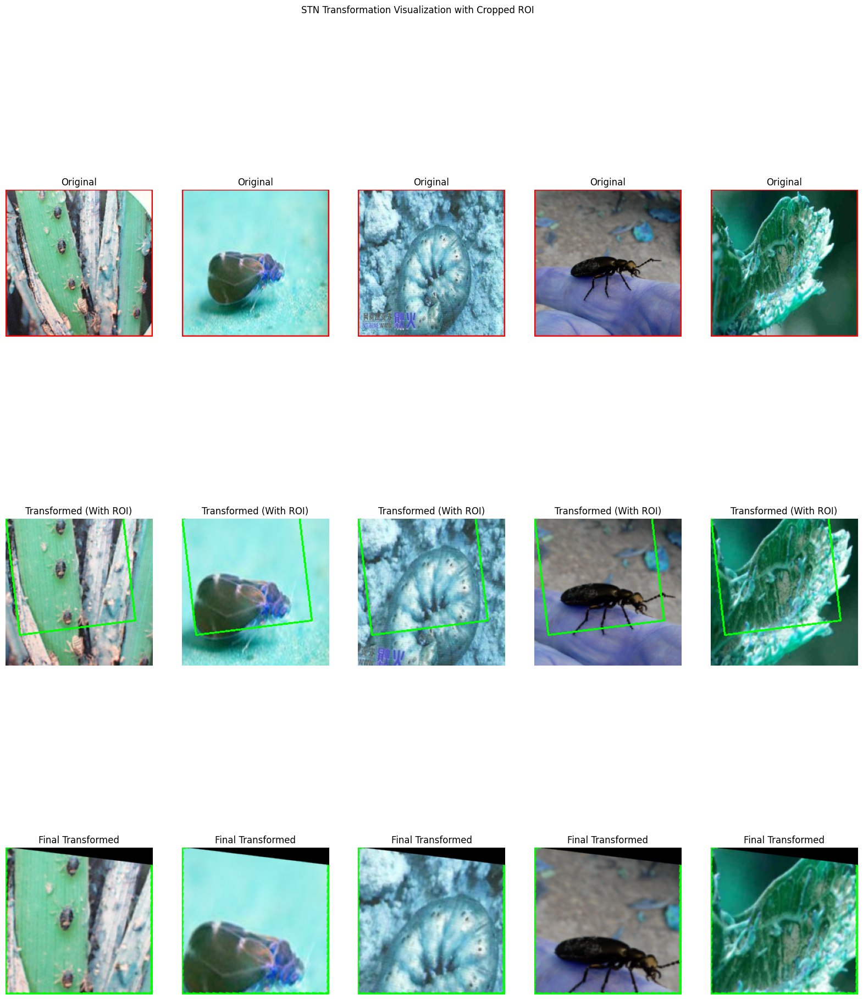

Epoch [2/20], Batch [1/1410] - Loss: 1.2657
Epoch [2/20], Batch [2/1410] - Loss: 1.1301
Epoch [2/20], Batch [3/1410] - Loss: 1.0929
Epoch [2/20], Batch [4/1410] - Loss: 1.7194
Epoch [2/20], Batch [5/1410] - Loss: 1.2581
Epoch [2/20], Batch [6/1410] - Loss: 0.9181
Epoch [2/20], Batch [7/1410] - Loss: 1.3910
Epoch [2/20], Batch [8/1410] - Loss: 1.5918
Epoch [2/20], Batch [9/1410] - Loss: 1.3106
Epoch [2/20], Batch [10/1410] - Loss: 0.9799
Epoch [2/20], Batch [11/1410] - Loss: 1.3535
Epoch [2/20], Batch [12/1410] - Loss: 1.1181
Epoch [2/20], Batch [13/1410] - Loss: 0.9501
Epoch [2/20], Batch [14/1410] - Loss: 1.2054
Epoch [2/20], Batch [15/1410] - Loss: 0.6767
Epoch [2/20], Batch [16/1410] - Loss: 0.8577
Epoch [2/20], Batch [17/1410] - Loss: 1.0296
Epoch [2/20], Batch [18/1410] - Loss: 1.1066
Epoch [2/20], Batch [19/1410] - Loss: 1.4446
Epoch [2/20], Batch [20/1410] - Loss: 0.9105
Epoch [2/20], Batch [21/1410] - Loss: 0.8424
Epoch [2/20], Batch [22/1410] - Loss: 1.6257
Epoch [2/20], Batch

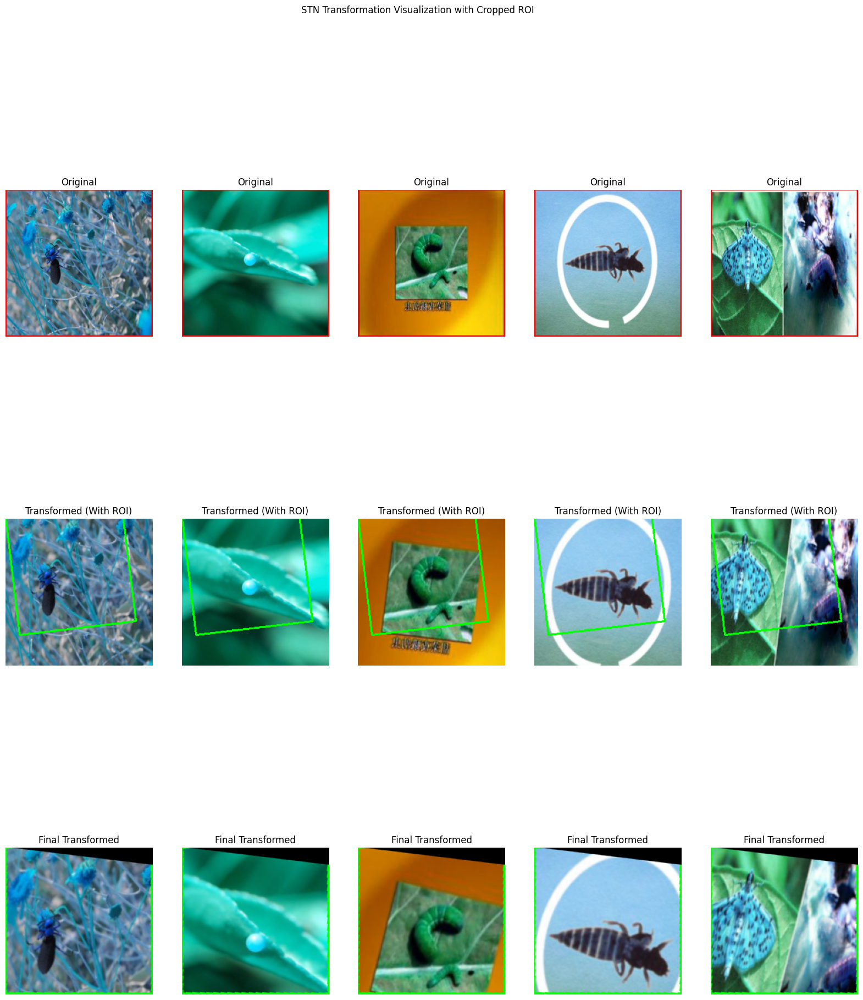

Epoch [3/20], Batch [1/1410] - Loss: 0.7165
Epoch [3/20], Batch [2/1410] - Loss: 1.1311
Epoch [3/20], Batch [3/1410] - Loss: 0.5309
Epoch [3/20], Batch [4/1410] - Loss: 1.0217
Epoch [3/20], Batch [5/1410] - Loss: 1.0944
Epoch [3/20], Batch [6/1410] - Loss: 0.7666
Epoch [3/20], Batch [7/1410] - Loss: 0.8860
Epoch [3/20], Batch [8/1410] - Loss: 0.7857
Epoch [3/20], Batch [9/1410] - Loss: 0.9977
Epoch [3/20], Batch [10/1410] - Loss: 1.1710
Epoch [3/20], Batch [11/1410] - Loss: 1.2015
Epoch [3/20], Batch [12/1410] - Loss: 0.7526
Epoch [3/20], Batch [13/1410] - Loss: 0.7877
Epoch [3/20], Batch [14/1410] - Loss: 0.5503
Epoch [3/20], Batch [15/1410] - Loss: 0.7396
Epoch [3/20], Batch [16/1410] - Loss: 0.7363
Epoch [3/20], Batch [17/1410] - Loss: 0.9639
Epoch [3/20], Batch [18/1410] - Loss: 0.7076
Epoch [3/20], Batch [19/1410] - Loss: 0.5593
Epoch [3/20], Batch [20/1410] - Loss: 0.8523
Epoch [3/20], Batch [21/1410] - Loss: 0.7518
Epoch [3/20], Batch [22/1410] - Loss: 0.8498
Epoch [3/20], Batch

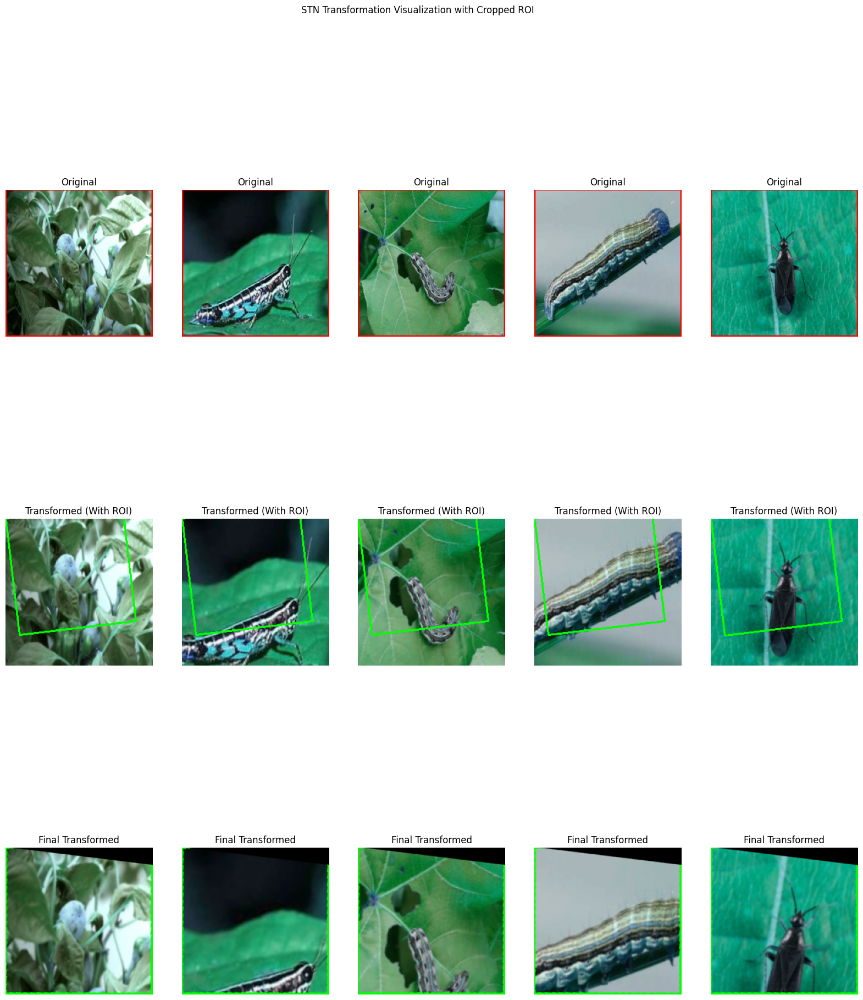

Epoch [4/20], Batch [1/1410] - Loss: 0.6037
Epoch [4/20], Batch [2/1410] - Loss: 0.6953
Epoch [4/20], Batch [3/1410] - Loss: 0.6531
Epoch [4/20], Batch [4/1410] - Loss: 0.7209
Epoch [4/20], Batch [5/1410] - Loss: 0.8211
Epoch [4/20], Batch [6/1410] - Loss: 0.6299
Epoch [4/20], Batch [7/1410] - Loss: 0.6733
Epoch [4/20], Batch [8/1410] - Loss: 0.3873
Epoch [4/20], Batch [9/1410] - Loss: 0.7218
Epoch [4/20], Batch [10/1410] - Loss: 0.5770
Epoch [4/20], Batch [11/1410] - Loss: 0.4688
Epoch [4/20], Batch [12/1410] - Loss: 0.8625
Epoch [4/20], Batch [13/1410] - Loss: 0.4895
Epoch [4/20], Batch [14/1410] - Loss: 0.5008
Epoch [4/20], Batch [15/1410] - Loss: 0.5841
Epoch [4/20], Batch [16/1410] - Loss: 0.4233
Epoch [4/20], Batch [17/1410] - Loss: 0.7689
Epoch [4/20], Batch [18/1410] - Loss: 0.5230
Epoch [4/20], Batch [19/1410] - Loss: 0.4985
Epoch [4/20], Batch [20/1410] - Loss: 0.6988
Epoch [4/20], Batch [21/1410] - Loss: 0.6281
Epoch [4/20], Batch [22/1410] - Loss: 0.1932
Epoch [4/20], Batch

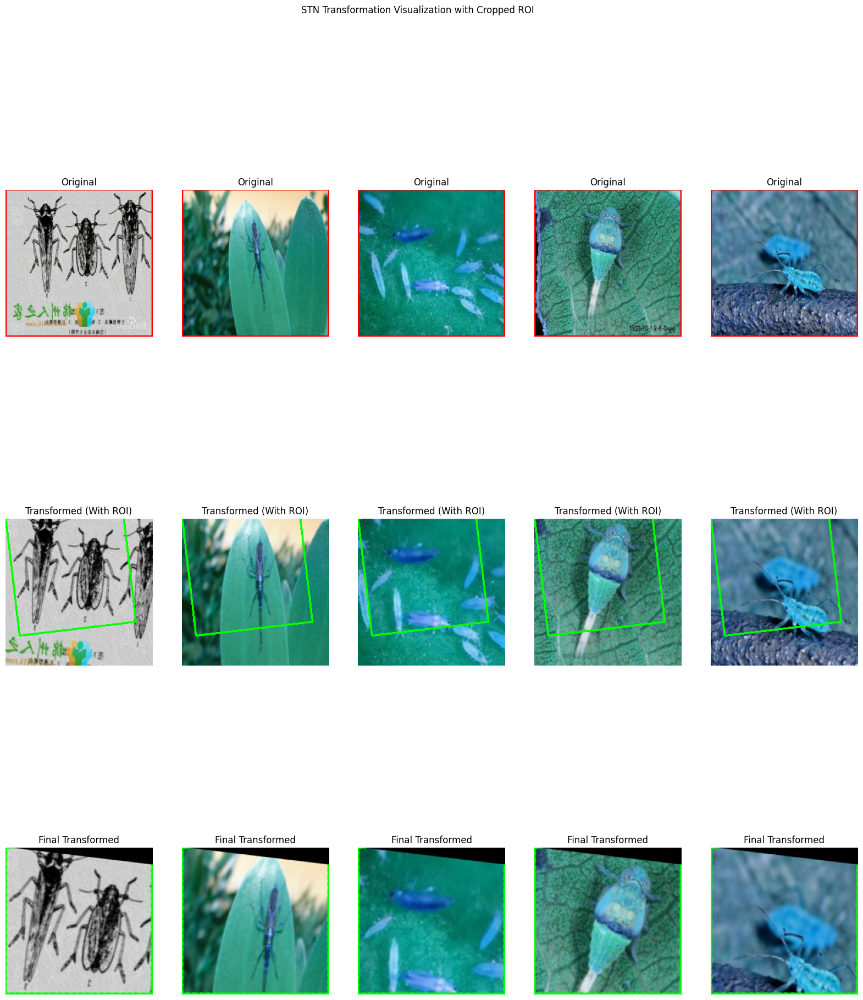

Epoch [5/20], Batch [1/1410] - Loss: 0.4902
Epoch [5/20], Batch [2/1410] - Loss: 0.4718
Epoch [5/20], Batch [3/1410] - Loss: 0.4801
Epoch [5/20], Batch [4/1410] - Loss: 0.4286
Epoch [5/20], Batch [5/1410] - Loss: 0.7649
Epoch [5/20], Batch [6/1410] - Loss: 0.4041
Epoch [5/20], Batch [7/1410] - Loss: 0.7582
Epoch [5/20], Batch [8/1410] - Loss: 0.5636
Epoch [5/20], Batch [9/1410] - Loss: 0.7390
Epoch [5/20], Batch [10/1410] - Loss: 0.4507
Epoch [5/20], Batch [11/1410] - Loss: 0.6556
Epoch [5/20], Batch [12/1410] - Loss: 0.3887
Epoch [5/20], Batch [13/1410] - Loss: 0.9275
Epoch [5/20], Batch [14/1410] - Loss: 0.6223
Epoch [5/20], Batch [15/1410] - Loss: 0.3658
Epoch [5/20], Batch [16/1410] - Loss: 0.5386
Epoch [5/20], Batch [17/1410] - Loss: 0.4258
Epoch [5/20], Batch [18/1410] - Loss: 0.3509
Epoch [5/20], Batch [19/1410] - Loss: 0.3951
Epoch [5/20], Batch [20/1410] - Loss: 0.3884
Epoch [5/20], Batch [21/1410] - Loss: 0.4281
Epoch [5/20], Batch [22/1410] - Loss: 0.4966
Epoch [5/20], Batch

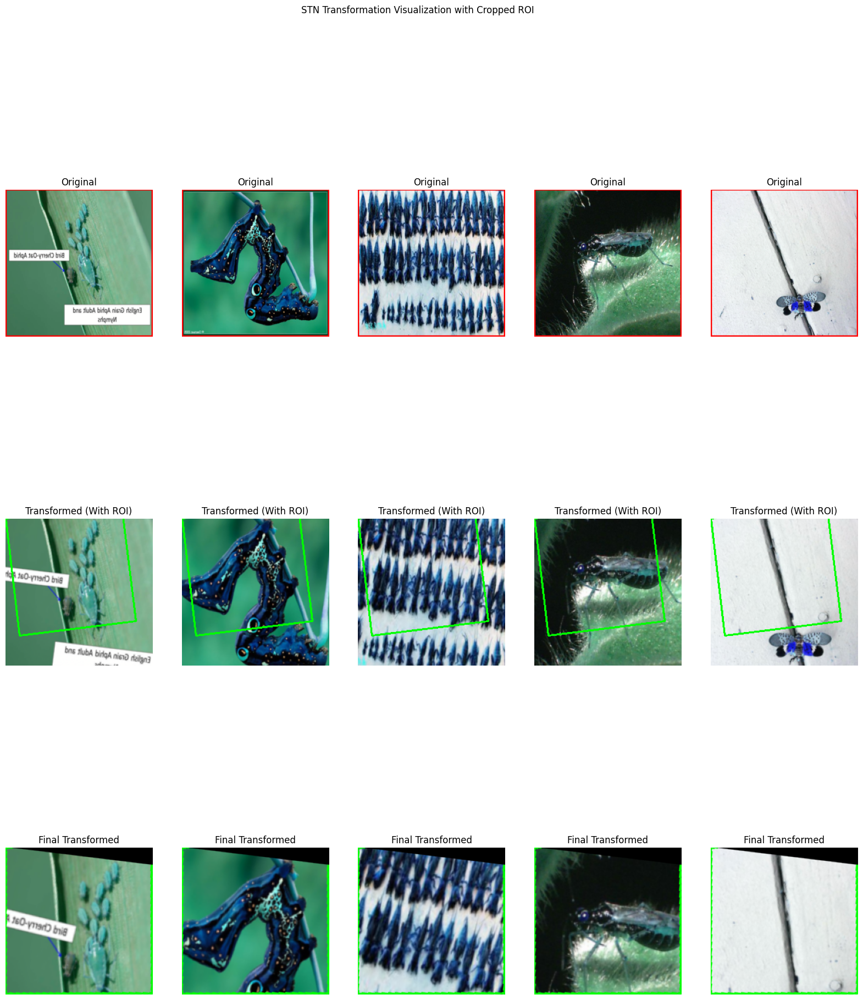

Epoch [6/20], Batch [1/1410] - Loss: 0.4893
Epoch [6/20], Batch [2/1410] - Loss: 0.3320
Epoch [6/20], Batch [3/1410] - Loss: 0.3270
Epoch [6/20], Batch [4/1410] - Loss: 0.3851
Epoch [6/20], Batch [5/1410] - Loss: 0.4680
Epoch [6/20], Batch [6/1410] - Loss: 0.3855
Epoch [6/20], Batch [7/1410] - Loss: 0.4635
Epoch [6/20], Batch [8/1410] - Loss: 0.3491
Epoch [6/20], Batch [9/1410] - Loss: 0.4016
Epoch [6/20], Batch [10/1410] - Loss: 0.1522
Epoch [6/20], Batch [11/1410] - Loss: 0.2669
Epoch [6/20], Batch [12/1410] - Loss: 0.2158
Epoch [6/20], Batch [13/1410] - Loss: 0.2888
Epoch [6/20], Batch [14/1410] - Loss: 0.4478
Epoch [6/20], Batch [15/1410] - Loss: 0.3001
Epoch [6/20], Batch [16/1410] - Loss: 0.9527
Epoch [6/20], Batch [17/1410] - Loss: 0.3733
Epoch [6/20], Batch [18/1410] - Loss: 0.5511
Epoch [6/20], Batch [19/1410] - Loss: 0.4771
Epoch [6/20], Batch [20/1410] - Loss: 0.4429
Epoch [6/20], Batch [21/1410] - Loss: 0.5986
Epoch [6/20], Batch [22/1410] - Loss: 0.2716
Epoch [6/20], Batch

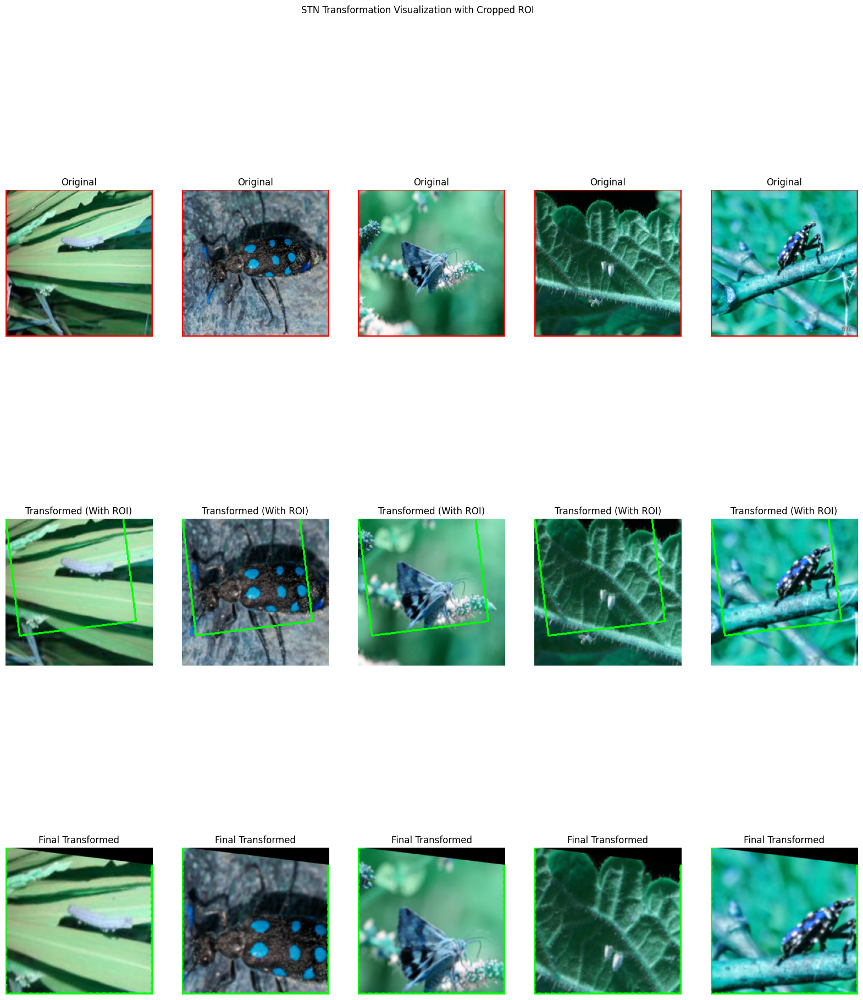

Epoch [7/20], Batch [1/1410] - Loss: 0.2159
Epoch [7/20], Batch [2/1410] - Loss: 0.2658
Epoch [7/20], Batch [3/1410] - Loss: 0.3733
Epoch [7/20], Batch [4/1410] - Loss: 0.5611
Epoch [7/20], Batch [5/1410] - Loss: 0.4014
Epoch [7/20], Batch [6/1410] - Loss: 0.2055
Epoch [7/20], Batch [7/1410] - Loss: 0.4979
Epoch [7/20], Batch [8/1410] - Loss: 0.4969
Epoch [7/20], Batch [9/1410] - Loss: 0.3937
Epoch [7/20], Batch [10/1410] - Loss: 0.1937
Epoch [7/20], Batch [11/1410] - Loss: 0.2796
Epoch [7/20], Batch [12/1410] - Loss: 0.4091
Epoch [7/20], Batch [13/1410] - Loss: 0.7999
Epoch [7/20], Batch [14/1410] - Loss: 0.1995
Epoch [7/20], Batch [15/1410] - Loss: 0.0575
Epoch [7/20], Batch [16/1410] - Loss: 0.2021
Epoch [7/20], Batch [17/1410] - Loss: 0.3497
Epoch [7/20], Batch [18/1410] - Loss: 0.2357
Epoch [7/20], Batch [19/1410] - Loss: 0.2909
Epoch [7/20], Batch [20/1410] - Loss: 0.2542
Epoch [7/20], Batch [21/1410] - Loss: 0.2243
Epoch [7/20], Batch [22/1410] - Loss: 0.1954
Epoch [7/20], Batch

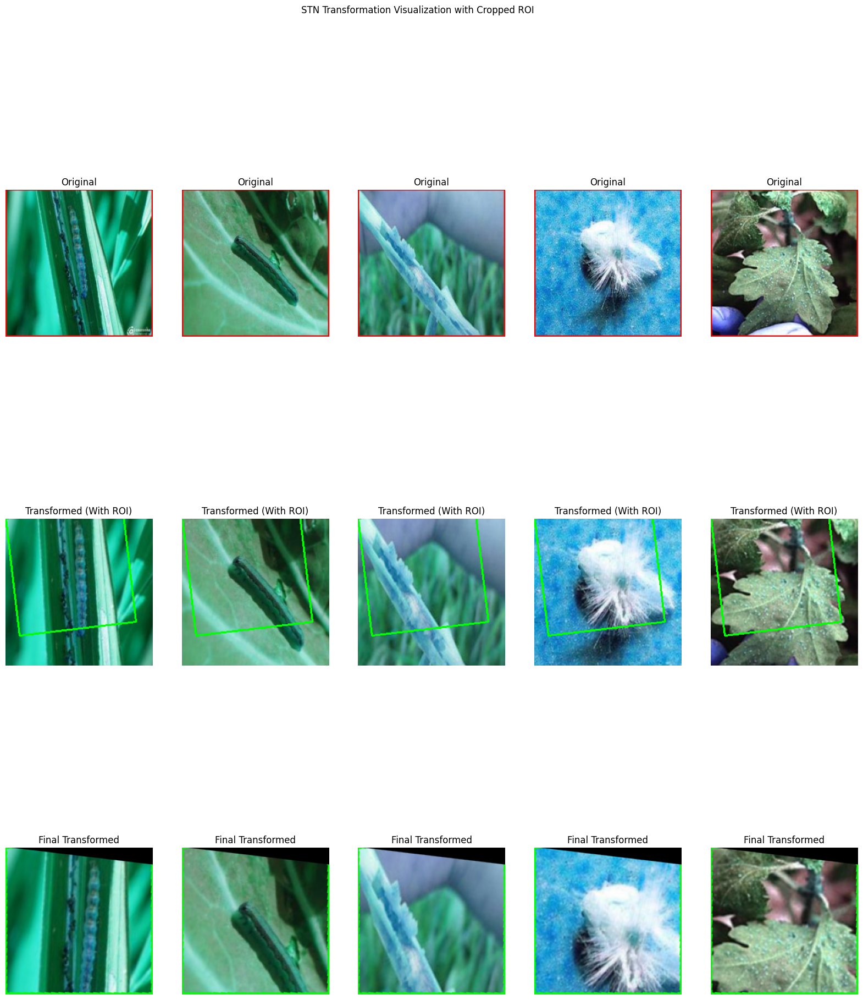

Epoch [8/20], Batch [1/1410] - Loss: 0.1900
Epoch [8/20], Batch [2/1410] - Loss: 0.2853
Epoch [8/20], Batch [3/1410] - Loss: 0.1569
Epoch [8/20], Batch [4/1410] - Loss: 0.3568
Epoch [8/20], Batch [5/1410] - Loss: 0.2526
Epoch [8/20], Batch [6/1410] - Loss: 0.5548
Epoch [8/20], Batch [7/1410] - Loss: 0.3517
Epoch [8/20], Batch [8/1410] - Loss: 0.2992
Epoch [8/20], Batch [9/1410] - Loss: 0.2193
Epoch [8/20], Batch [10/1410] - Loss: 0.5199
Epoch [8/20], Batch [11/1410] - Loss: 0.4164
Epoch [8/20], Batch [12/1410] - Loss: 0.2703
Epoch [8/20], Batch [13/1410] - Loss: 0.3098
Epoch [8/20], Batch [14/1410] - Loss: 0.2949
Epoch [8/20], Batch [15/1410] - Loss: 0.3256
Epoch [8/20], Batch [16/1410] - Loss: 0.2898
Epoch [8/20], Batch [17/1410] - Loss: 0.4085
Epoch [8/20], Batch [18/1410] - Loss: 0.1535
Epoch [8/20], Batch [19/1410] - Loss: 0.3829
Epoch [8/20], Batch [20/1410] - Loss: 0.2779
Epoch [8/20], Batch [21/1410] - Loss: 0.5592
Epoch [8/20], Batch [22/1410] - Loss: 0.2314
Epoch [8/20], Batch

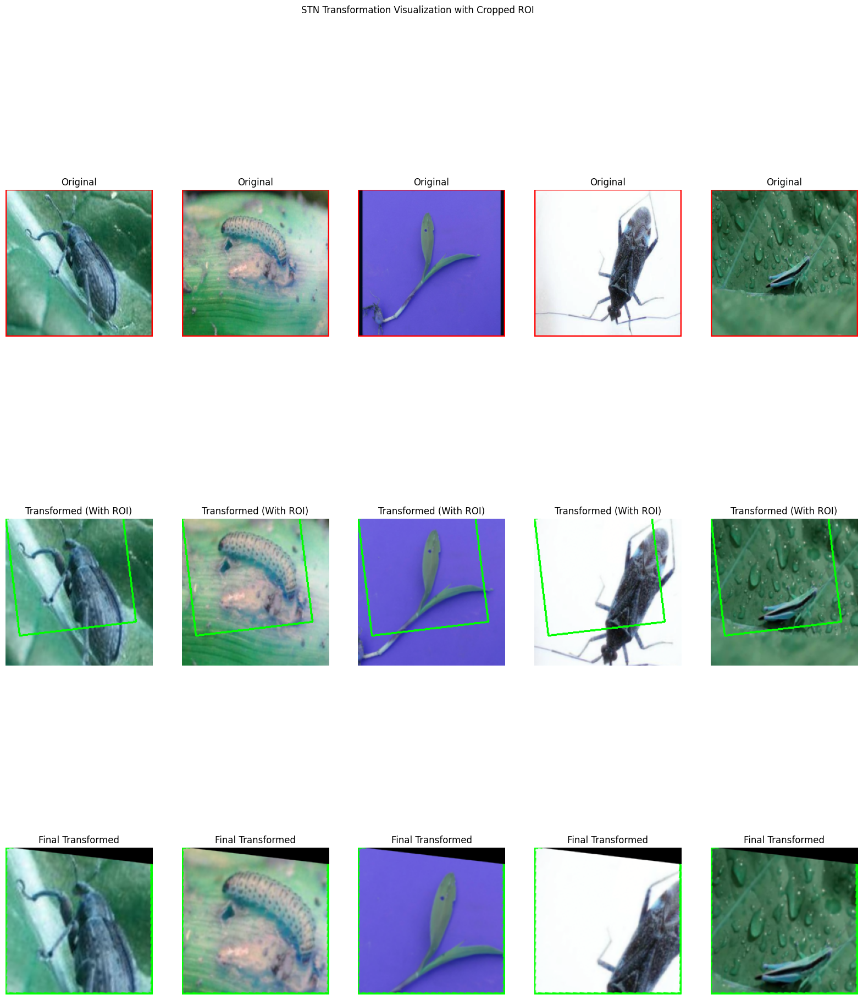

Epoch [9/20], Batch [1/1410] - Loss: 0.2919
Epoch [9/20], Batch [2/1410] - Loss: 0.0973
Epoch [9/20], Batch [3/1410] - Loss: 0.2121
Epoch [9/20], Batch [4/1410] - Loss: 0.0985
Epoch [9/20], Batch [5/1410] - Loss: 0.0875
Epoch [9/20], Batch [6/1410] - Loss: 0.1885
Epoch [9/20], Batch [7/1410] - Loss: 0.0945
Epoch [9/20], Batch [8/1410] - Loss: 0.2510
Epoch [9/20], Batch [9/1410] - Loss: 0.1219
Epoch [9/20], Batch [10/1410] - Loss: 0.4140
Epoch [9/20], Batch [11/1410] - Loss: 0.0892
Epoch [9/20], Batch [12/1410] - Loss: 0.1722
Epoch [9/20], Batch [13/1410] - Loss: 0.1385
Epoch [9/20], Batch [14/1410] - Loss: 0.1860
Epoch [9/20], Batch [15/1410] - Loss: 0.5945
Epoch [9/20], Batch [16/1410] - Loss: 0.0722
Epoch [9/20], Batch [17/1410] - Loss: 0.2824
Epoch [9/20], Batch [18/1410] - Loss: 0.1445
Epoch [9/20], Batch [19/1410] - Loss: 0.1425
Epoch [9/20], Batch [20/1410] - Loss: 0.2081
Epoch [9/20], Batch [21/1410] - Loss: 0.3447
Epoch [9/20], Batch [22/1410] - Loss: 0.1986
Epoch [9/20], Batch

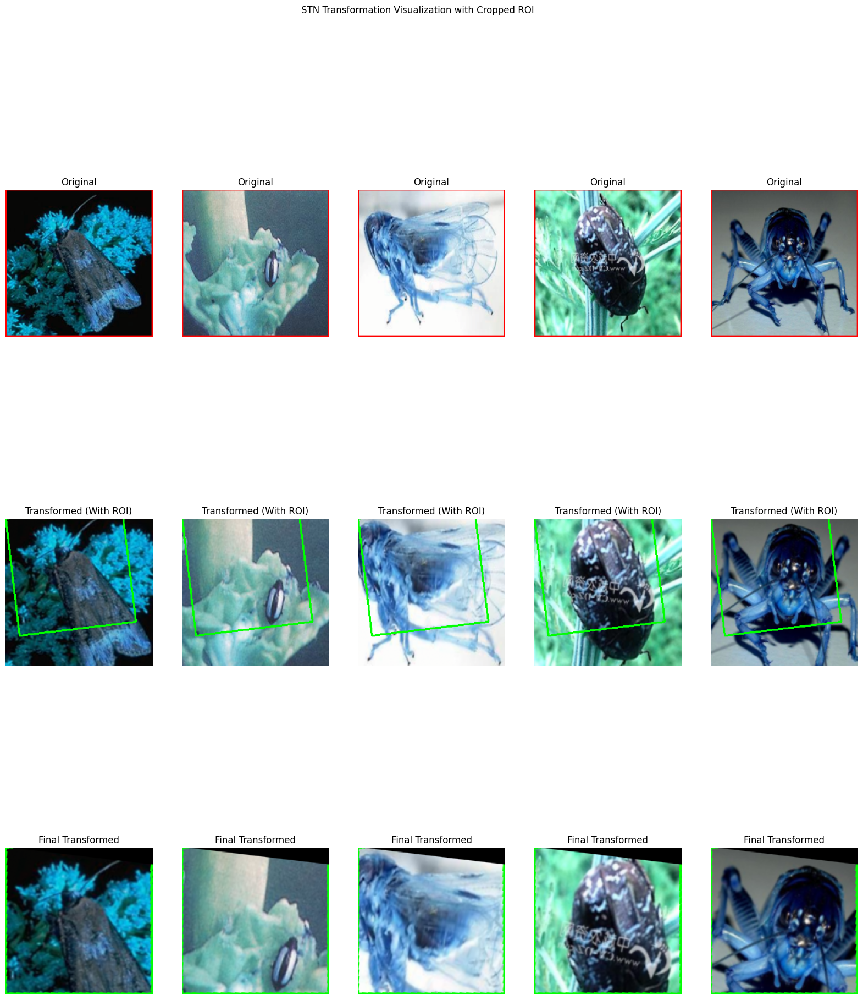

Epoch [10/20], Batch [1/1410] - Loss: 0.2366
Epoch [10/20], Batch [2/1410] - Loss: 0.1110
Epoch [10/20], Batch [3/1410] - Loss: 0.4196
Epoch [10/20], Batch [4/1410] - Loss: 0.2441
Epoch [10/20], Batch [5/1410] - Loss: 0.2197
Epoch [10/20], Batch [6/1410] - Loss: 0.2337
Epoch [10/20], Batch [7/1410] - Loss: 0.5863
Epoch [10/20], Batch [8/1410] - Loss: 0.3010
Epoch [10/20], Batch [9/1410] - Loss: 0.1279
Epoch [10/20], Batch [10/1410] - Loss: 0.2402
Epoch [10/20], Batch [11/1410] - Loss: 0.0892
Epoch [10/20], Batch [12/1410] - Loss: 0.2375
Epoch [10/20], Batch [13/1410] - Loss: 0.0937
Epoch [10/20], Batch [14/1410] - Loss: 0.4500
Epoch [10/20], Batch [15/1410] - Loss: 0.1954
Epoch [10/20], Batch [16/1410] - Loss: 0.7856
Epoch [10/20], Batch [17/1410] - Loss: 0.2162
Epoch [10/20], Batch [18/1410] - Loss: 0.2156
Epoch [10/20], Batch [19/1410] - Loss: 0.1617
Epoch [10/20], Batch [20/1410] - Loss: 0.1777
Epoch [10/20], Batch [21/1410] - Loss: 0.4394
Epoch [10/20], Batch [22/1410] - Loss: 0.41

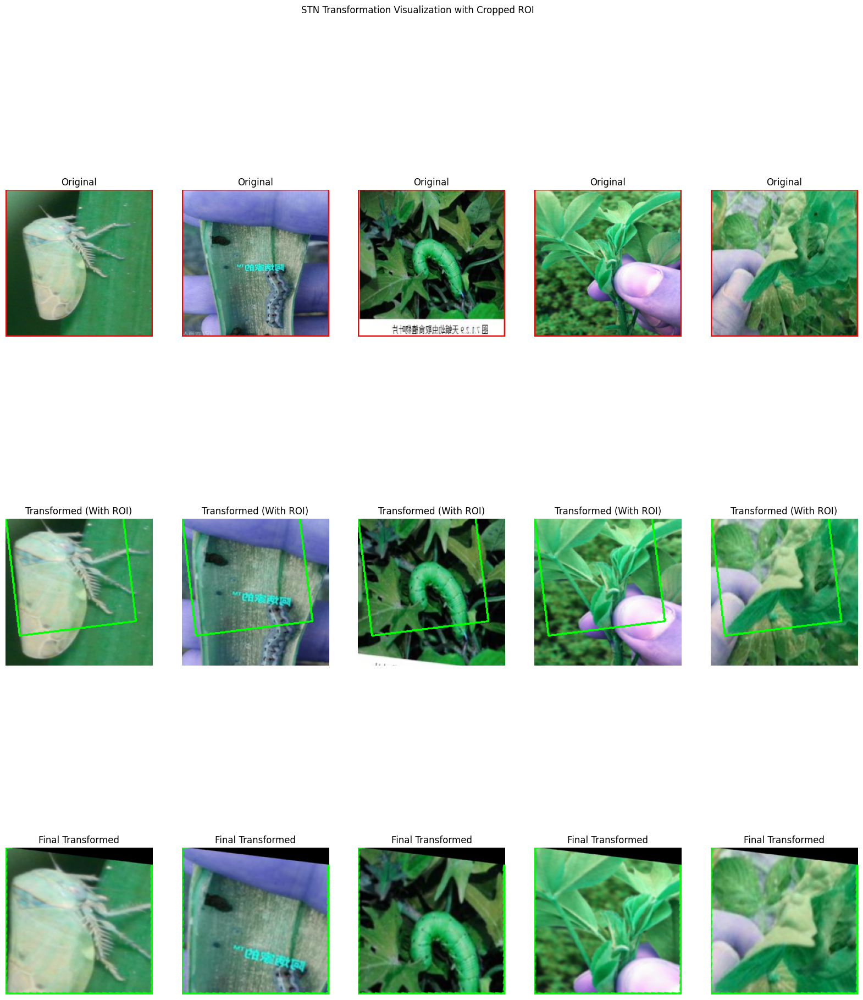

Epoch [11/20], Batch [1/1410] - Loss: 0.2823
Epoch [11/20], Batch [2/1410] - Loss: 0.1798
Epoch [11/20], Batch [3/1410] - Loss: 0.2699
Epoch [11/20], Batch [4/1410] - Loss: 0.3336
Epoch [11/20], Batch [5/1410] - Loss: 0.0947
Epoch [11/20], Batch [6/1410] - Loss: 0.1089
Epoch [11/20], Batch [7/1410] - Loss: 0.1857
Epoch [11/20], Batch [8/1410] - Loss: 0.1006
Epoch [11/20], Batch [9/1410] - Loss: 0.0934
Epoch [11/20], Batch [10/1410] - Loss: 0.1555
Epoch [11/20], Batch [11/1410] - Loss: 0.1624
Epoch [11/20], Batch [12/1410] - Loss: 0.2627
Epoch [11/20], Batch [13/1410] - Loss: 0.1811
Epoch [11/20], Batch [14/1410] - Loss: 0.3055
Epoch [11/20], Batch [15/1410] - Loss: 0.2158
Epoch [11/20], Batch [16/1410] - Loss: 0.0647
Epoch [11/20], Batch [17/1410] - Loss: 0.1791
Epoch [11/20], Batch [18/1410] - Loss: 0.2693
Epoch [11/20], Batch [19/1410] - Loss: 0.0868
Epoch [11/20], Batch [20/1410] - Loss: 0.2837
Epoch [11/20], Batch [21/1410] - Loss: 0.1217
Epoch [11/20], Batch [22/1410] - Loss: 0.14

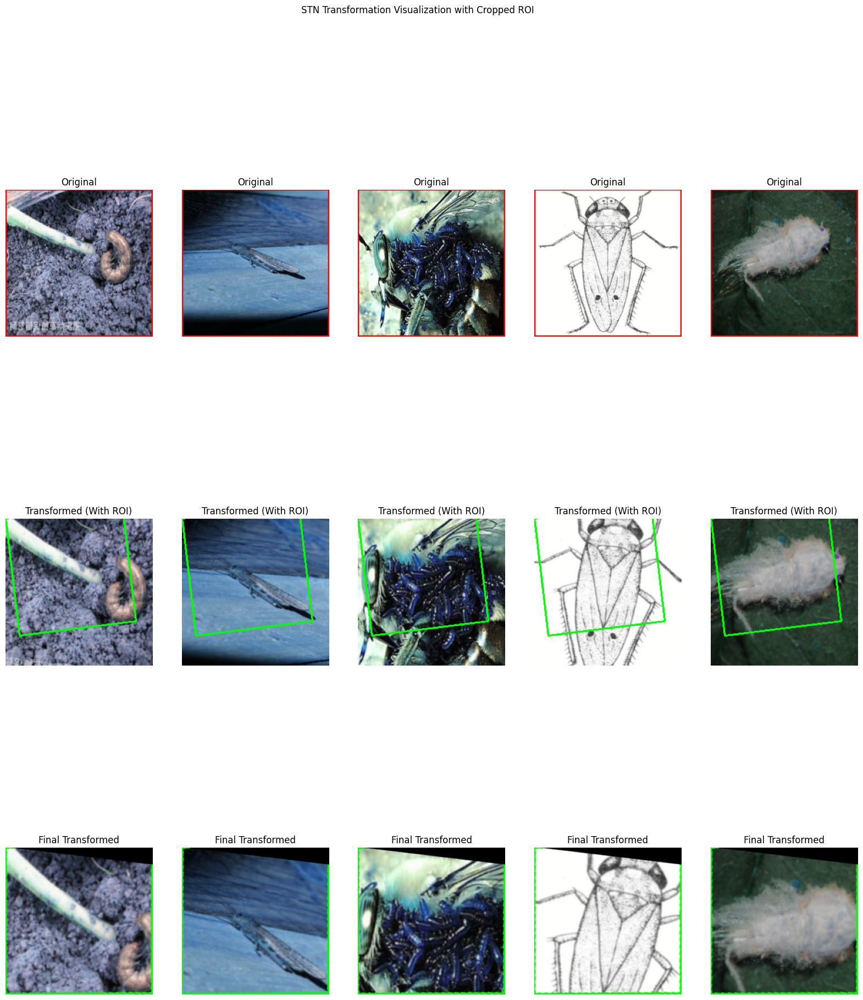

Epoch [12/20], Batch [1/1410] - Loss: 0.1589
Epoch [12/20], Batch [2/1410] - Loss: 0.1572
Epoch [12/20], Batch [3/1410] - Loss: 0.2037
Epoch [12/20], Batch [4/1410] - Loss: 0.1607
Epoch [12/20], Batch [5/1410] - Loss: 0.0241
Epoch [12/20], Batch [6/1410] - Loss: 0.2323
Epoch [12/20], Batch [7/1410] - Loss: 0.2172
Epoch [12/20], Batch [8/1410] - Loss: 0.4693
Epoch [12/20], Batch [9/1410] - Loss: 0.7236
Epoch [12/20], Batch [10/1410] - Loss: 0.1124
Epoch [12/20], Batch [11/1410] - Loss: 0.1869
Epoch [12/20], Batch [12/1410] - Loss: 0.1082
Epoch [12/20], Batch [13/1410] - Loss: 0.1297
Epoch [12/20], Batch [14/1410] - Loss: 0.1421
Epoch [12/20], Batch [15/1410] - Loss: 0.3355
Epoch [12/20], Batch [16/1410] - Loss: 0.0547
Epoch [12/20], Batch [17/1410] - Loss: 0.0462
Epoch [12/20], Batch [18/1410] - Loss: 0.1836
Epoch [12/20], Batch [19/1410] - Loss: 0.2046
Epoch [12/20], Batch [20/1410] - Loss: 0.5108
Epoch [12/20], Batch [21/1410] - Loss: 0.2312
Epoch [12/20], Batch [22/1410] - Loss: 0.05

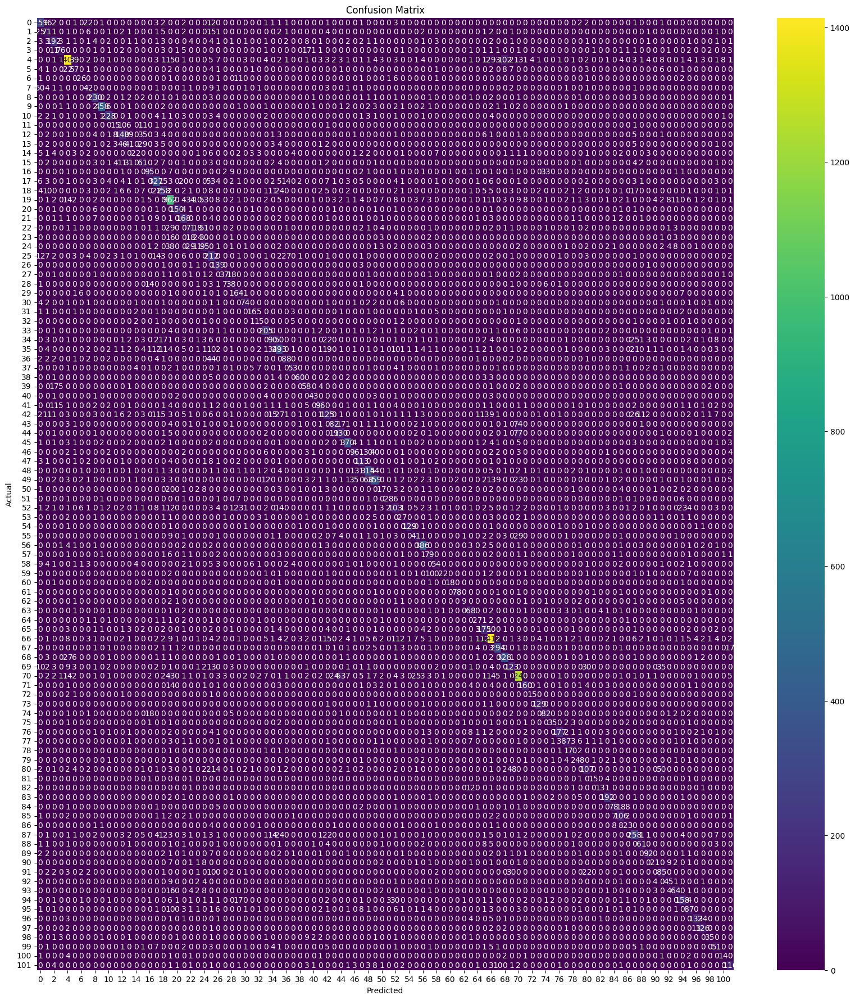

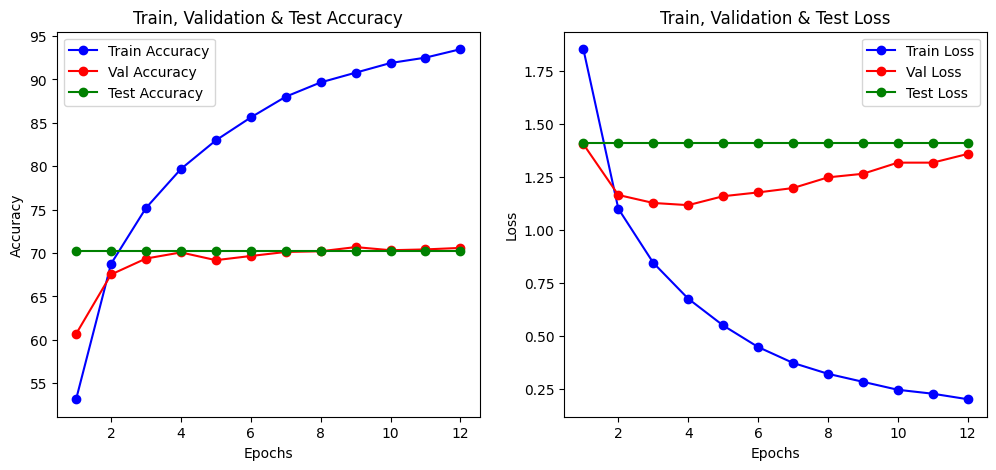

In [ ]:
# Train and Evaluate
train_accs, val_accs, train_losses, val_losses = train_model(model, train_loader, val_loader, epochs=20, patience=3)
test_acc, test_loss = test_model(model, test_loader)
plot_graphs(train_accs, val_accs, [test_acc] * len(train_accs), train_losses, val_losses, [test_loss] * len(train_accs))

In [1]:
def predict_image(model, image_path, class_names):
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])

    image = Image.open(image_path).convert("RGB")
    input_tensor = transform(image).unsqueeze(0).to(device)

    model.eval()
    with torch.no_grad():
        output = model(input_tensor)
        _, predicted = torch.max(output, 1)

    predicted_class = class_names[predicted.item()]

    plt.imshow(image)
    plt.title(f"Predicted Class: {predicted_class}")
    plt.axis("off")
    plt.show()

    print(f"Predicted Class: {predicted_class}")


In [16]:
# During the training (or saving) phase:
torch.save(model.state_dict(), "/content/pest_classifier_best.pth")

# During the loading phase:
model = PestClassifier(num_classes=102).to(device)  # Initialize the model first
model.load_state_dict(torch.load("/content/pest_classifier_best.pth")) # Then load the state dictionary

<All keys matched successfully>

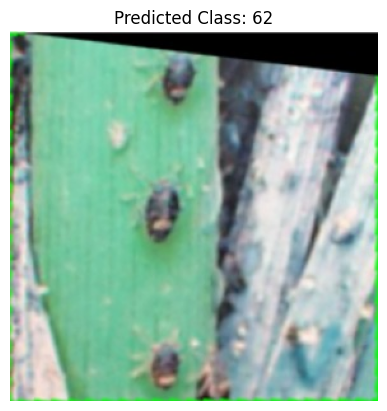

Predicted Class: 62


In [18]:
# Example Usage for Predicting a Random Image
image_path = "/content/test.jpg"  # Change this to an actual image path
predict_image(model, image_path, classes)